---
## Import required libraries

In [78]:
import contextily as cx
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

---
## Import the CSV data to a dataframe and drop unnecessary columns

In [79]:
df = pd.read_csv('SF_Bay_Area_Mako_Data.csv')
df = df.drop(['Unnamed: 0', 'description', 'alt'], axis=1)
df

,chemical,name,coordinates,flight,lon,lat
0,"1,1,1,2-TETRAFLUOROETHANE",TAR_Long View_200618_191334_v1s,"(-122.188079, 37.7852, 0.0)",Flight 200618a,-122.188079,37.785200
1,"1,1-DIFLUOROETHANE",TAR_Long View_200618_191334_v1s,"(-122.178125, 37.79647, 0.0)",Flight 200618a,-122.178125,37.796470
2,AMMONIA,TAR_Long View_200618_180727_v1s,"(-122.219799, 38.087409, 0.0)",Flight 200618a,-122.219799,38.087409
3,AMMONIA,TAR_Long View_200618_181921_v1s,"(-122.400814, 37.949141, 0.0)",Flight 200618a,-122.400814,37.949141
4,AMMONIA,TAR_Long View_200618_183426_v1s,"(-122.391668, 37.787369, 0.0)",Flight 200618a,-122.391668,37.787369
...,...,...,...,...,...,...
304,METHANE,TAR_Gemini_230326_235632_v1s,"(-122.140914, 38.075133, 0.0)",Flight 230326b,-122.140914,38.075133
305,METHANE,TAR_Gemini_230327_000721_v1s,"(-122.113472, 38.014515, 0.0)",Flight 230326b,-122.113472,38.014515
306,NITROUS OXIDE,TAR_Gemini_230326_233515_v1s,"(-122.36373, 37.948553, 0.0)",Flight 230326b,-122.363730,37.948553
307,PROPENE,TAR_Gemini_230326_233515_v1s,"(-122.400386, 37.949144, 0.0)",Flight 230326b,-122.400386,37.949144


---
## Defining Functions

In [80]:
# Function to filter for a given area and add them to a new dataframe
def area_crop(df, min_lat, max_lat, min_lon, max_lon, global_vars=None):
    mask = (
        (df['lat'] >= min_lat) &
        (df['lat'] <= max_lat) &
        (df['lon'] >= min_lon) &
        (df['lon'] <= max_lon))
    
    area_df = df.loc[mask].copy()
    return area_df

In [81]:
# Function to plot the chemicals in the area
def area_plot(title, area_df, min_lat, max_lat, min_lon, max_lon, global_vars=None):
    plt.figure(figsize=(14, 10))
    
    # Calculate chemical counts for ordering and legend labels
    chem_counts = area_df['chemical'].value_counts()
    hue_order = chem_counts.index.tolist()
    
    # Create plot with ordered legend
    ax = sns.scatterplot(x=area_df['lon'], y=area_df['lat'], hue=area_df['chemical'], hue_order=hue_order, alpha=1, s=300, marker='X')
    
    ax.set_xlim(min_lon, max_lon)
    ax.set_ylim(min_lat, max_lat)
    
    cx.add_basemap(ax, crs = "EPSG:4326", source=cx.providers.Esri.WorldImagery)
    
    # Customize legend
    handles, labels = ax.get_legend_handles_labels()
    new_labels = [f'{label} ({chem_counts[label]})' for label in labels]
    legend = ax.legend(handles, new_labels, title='Chemical', loc='upper left', bbox_to_anchor=(1, 1))
    legend.get_title().set_fontsize(12)
    
    ax.set_title(title, fontsize=20)
    ax.set_xlabel('Longitude', fontsize=12)
    ax.set_ylabel('Latitude', fontsize=12)
    
    plt.show()

---
## List of Identified Plumes:
Ammonia from Horse Sources
* Northwest Berkeley - California Thoroughbred Trainers / Ed Moger Racing Stable
* Horse stables?
* Skyline Ranch Equestrian Center

Refineries
* Chevron Refinery
* Phillips 66 San Francisco Refinery (Rodeo)
* Tesoro Golden Eagle Refinery
* Valero Benicia Refinery & Valero Asphalt

Other Plants
* Oakland Airport CNG Station
* Oakland - East Bay Wastewater Treatment and TrueZero Hydrogen Fuel Station
* Phillips 66 Carbon Plant
* San Francisco - Clearway Energy Steam Plant

Other broader areas
* Martinez Plume Cluster
* Richmond

---
## Northwest Berkeley

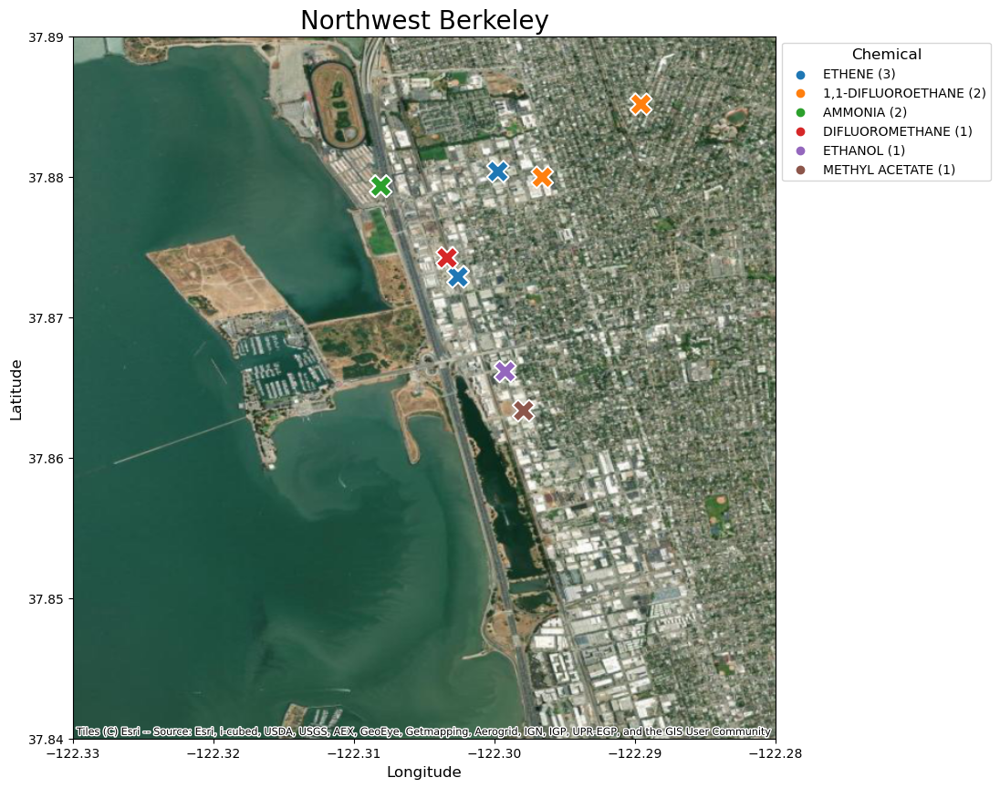

In [82]:
lat_min = 37.84
lat_max = 37.89
lon_min = -122.33
lon_max = -122.28
plumes = area_crop(df, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)
area_plot(title='Northwest Berkeley', area_df=plumes, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)


## California Thoroughbred Trainers
1100 Eastshore Hwy, Berkeley, CA 94710

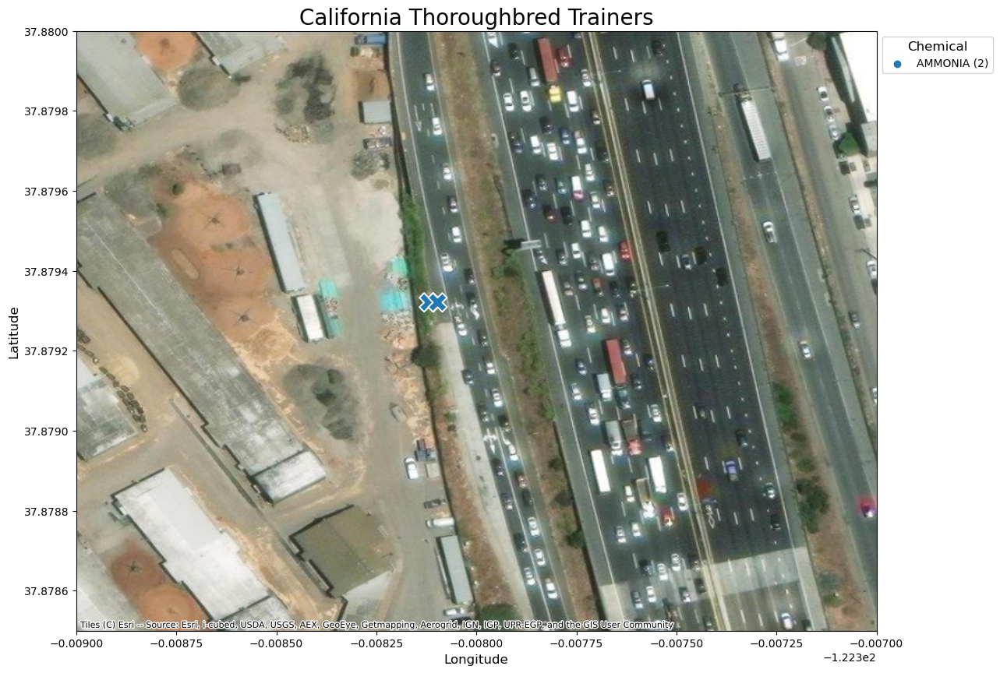

In [83]:
lat_min = 37.8785
lat_max = 37.8800
lon_min = -122.309
lon_max = -122.307
plumes = area_crop(df, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)
area_plot(title='California Thoroughbred Trainers', area_df=plumes, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)

---
## Horse Stables
2400 Valley View Rd, El Sobrante, CA 94803

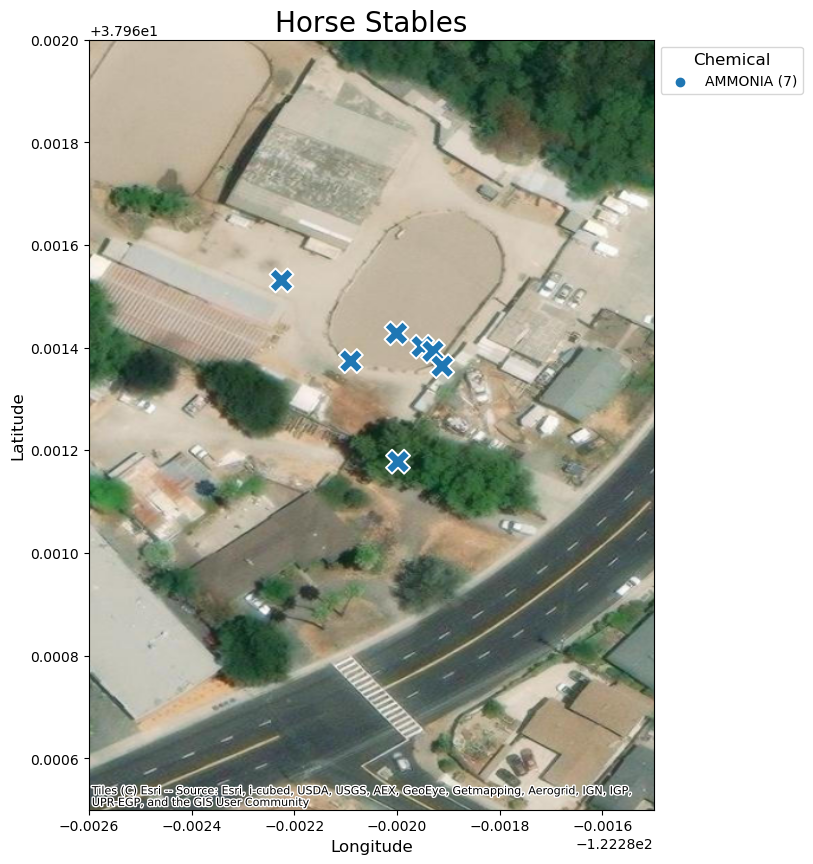

In [84]:
lat_min = 37.9605
lat_max = 37.9620
lon_min = -122.2826
lon_max = -122.2815
plumes = area_crop(df, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)
area_plot(title='Horse Stables', area_df=plumes, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)

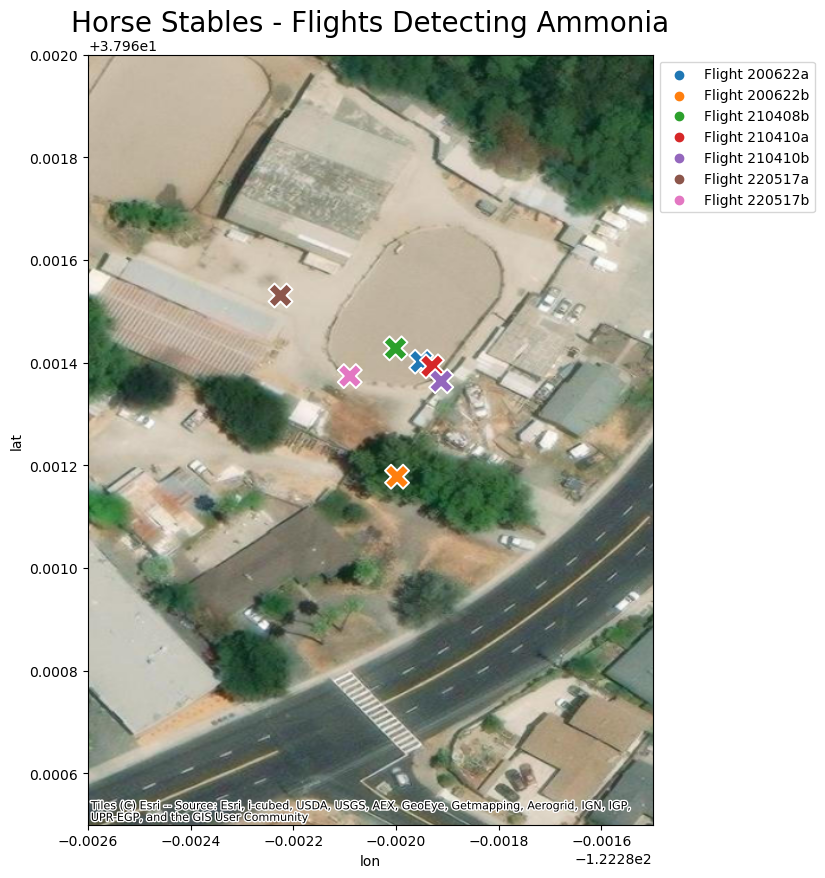

In [85]:
plt.figure(figsize=(14, 10))

df1 = df[
    (df['chemical'].isin(['AMMONIA'])) & 
    (df['lat'] >= 37.9605) & 
    (df['lat'] <= 37.9620) & 
    (df['lon'] >= -122.2826) & 
    (df['lon'] <= -122.2815)]

ax = sns.scatterplot(x=df1['lon'], y=df1['lat'], hue=df1['flight'], alpha=1, s=300, marker='X', legend=True)

plt.legend(title=None, loc='upper left', bbox_to_anchor=(1, 1))

ax.set_xlim(-122.2826, -122.2815)
ax.set_ylim(37.9605, 37.9620)
cx.add_basemap(ax, crs="EPSG:4326", source=cx.providers.Esri.WorldImagery)
ax.set_title('Horse Stables - Flights Detecting Ammonia', fontsize=20)

plt.show()

---
## Skyline Ranch Equestrian Center
5750 Redwood Rd, Oakland, CA 94619

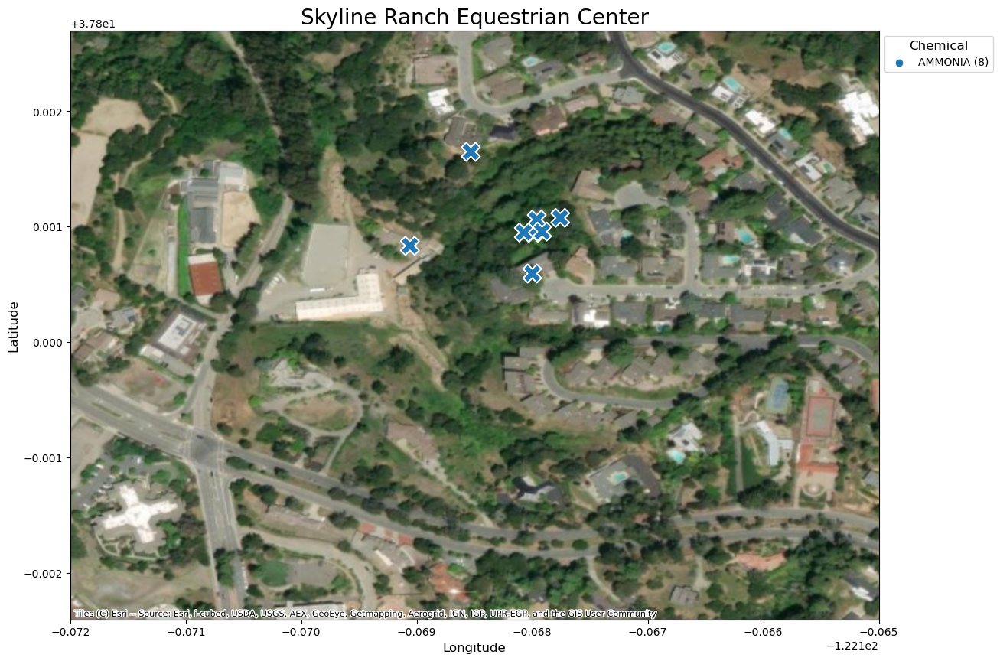

In [86]:
lat_min = 37.7976
lat_max = 37.8027
lon_min = -122.172
lon_max = -122.165
plumes = area_crop(df, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)
area_plot(title='Skyline Ranch Equestrian Center', area_df=plumes, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)

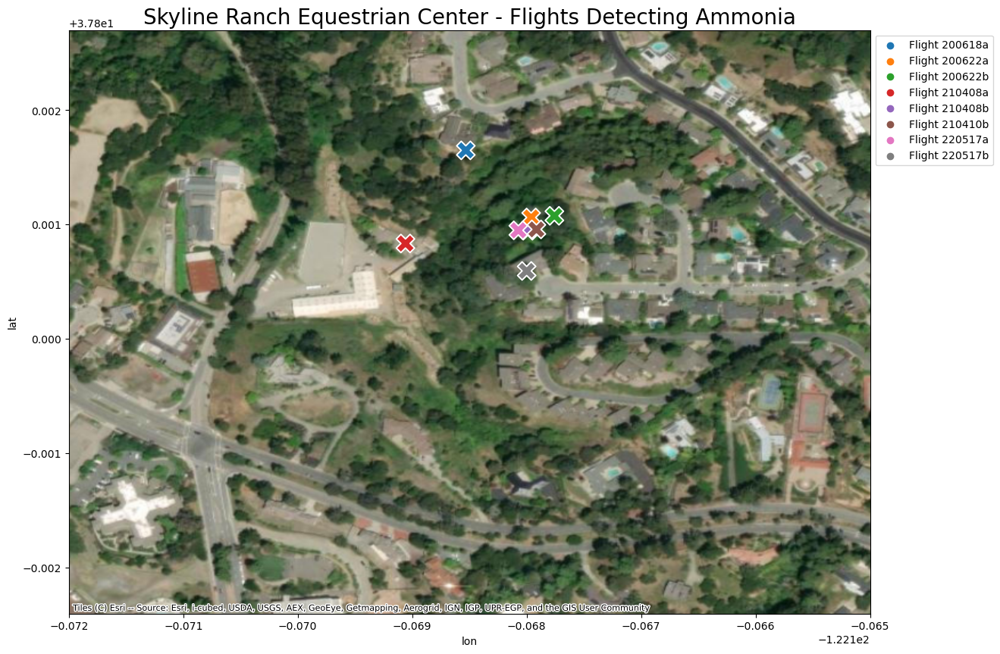

In [87]:
plt.figure(figsize=(14, 10))

df1 = df[
    (df['chemical'].isin(['AMMONIA'])) & 
    (df['lat'] >= 37.7976) & 
    (df['lat'] <= 37.8027) & 
    (df['lon'] >= -122.172) & 
    (df['lon'] <= -122.165)]

ax = sns.scatterplot(x=df1['lon'], y=df1['lat'], hue=df1['flight'], alpha=1, s=300, marker='X', legend=True)

plt.legend(title=None, loc='upper left', bbox_to_anchor=(1, 1))

ax.set_xlim(-122.172, -122.165)
ax.set_ylim(37.7976, 37.8027)
cx.add_basemap(ax, crs="EPSG:4326", source=cx.providers.Esri.WorldImagery)
ax.set_title('Skyline Ranch Equestrian Center - Flights Detecting Ammonia', fontsize=20)

plt.show()

---
## Chevron Refinery
841 Chevron Way, Richmond, CA 94801

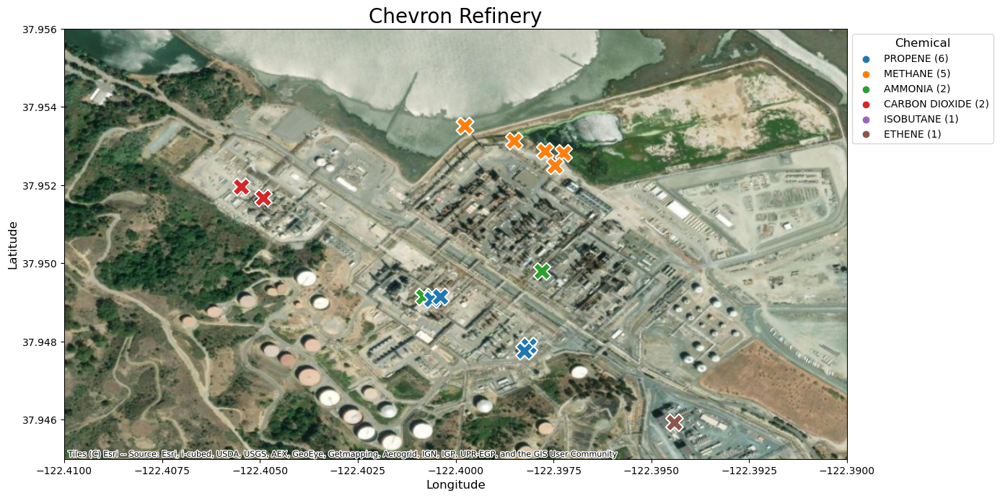

In [88]:
lat_min = 37.945
lat_max = 37.956
lon_min = -122.41
lon_max =  -122.39
plumes = area_crop(df, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)
area_plot(title='Chevron Refinery', area_df=plumes, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)

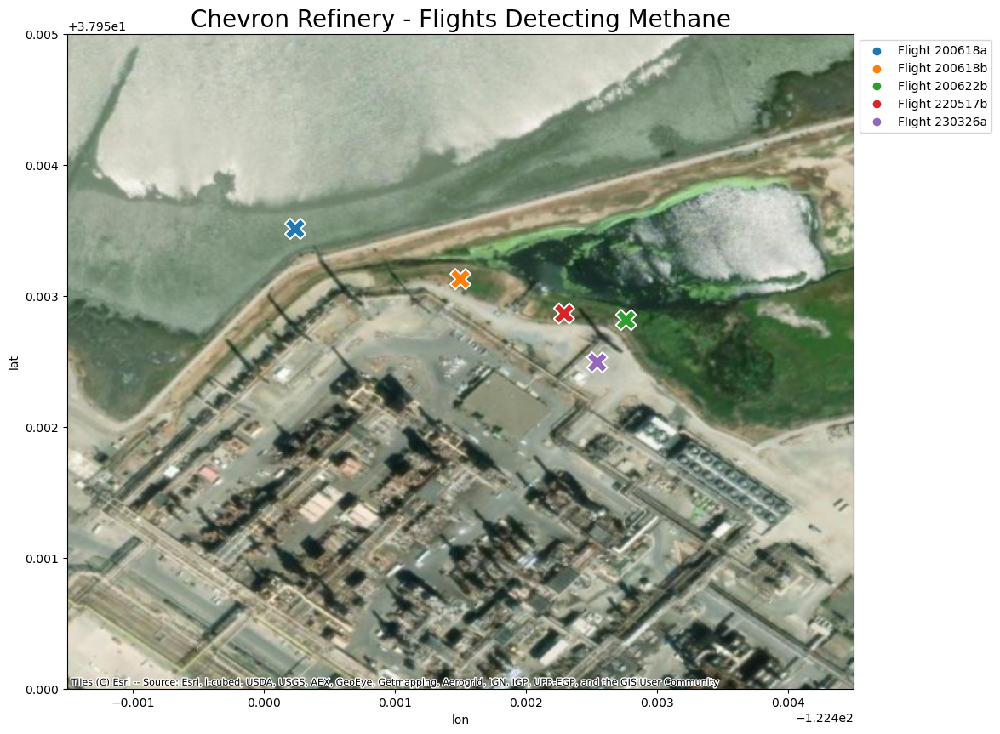

In [89]:
plt.figure(figsize=(14, 10))

df1 = df[
    (df['chemical'].isin(['METHANE'])) & 
    (df['lat'] >= 37.950) & 
    (df['lat'] <= 37.955) & 
    (df['lon'] >= -122.4015) & 
    (df['lon'] <= -122.3955)]

ax = sns.scatterplot(x=df1['lon'], y=df1['lat'], hue=df1['flight'], alpha=1, s=300, marker='X', legend=True)

plt.legend(title=None, loc='upper left', bbox_to_anchor=(1, 1))

ax.set_xlim(-122.4015, -122.3955)
ax.set_ylim(37.950, 37.955)
cx.add_basemap(ax, crs="EPSG:4326", source=cx.providers.Esri.WorldImagery)
ax.set_title('Chevron Refinery - Flights Detecting Methane', fontsize=20)

plt.show()

---
# Phillips 66 San Francisco Refinery
1290 San Pablo Ave, Rodeo, CA 94572

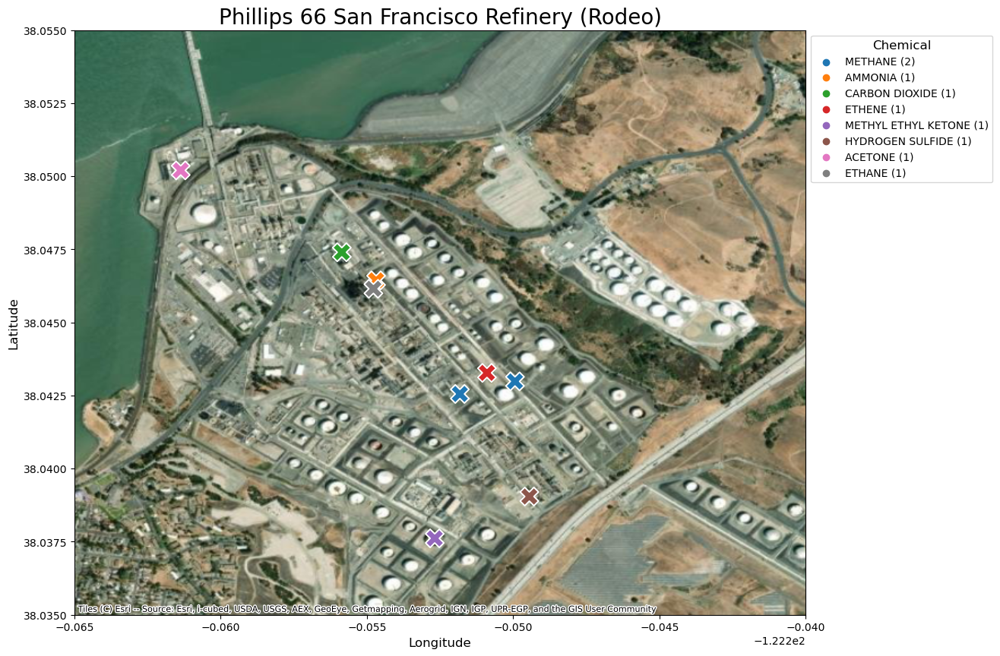

In [91]:
lat_min = 38.035
lat_max = 38.055
lon_min = -122.265
lon_max = -122.24
plumes = area_crop(df, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)
area_plot(title='Phillips 66 San Francisco Refinery (Rodeo)', area_df=plumes, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)

---
# Tesoro Golden Eagle Refinery
150 Solano Way, Pacheco, CA 94553

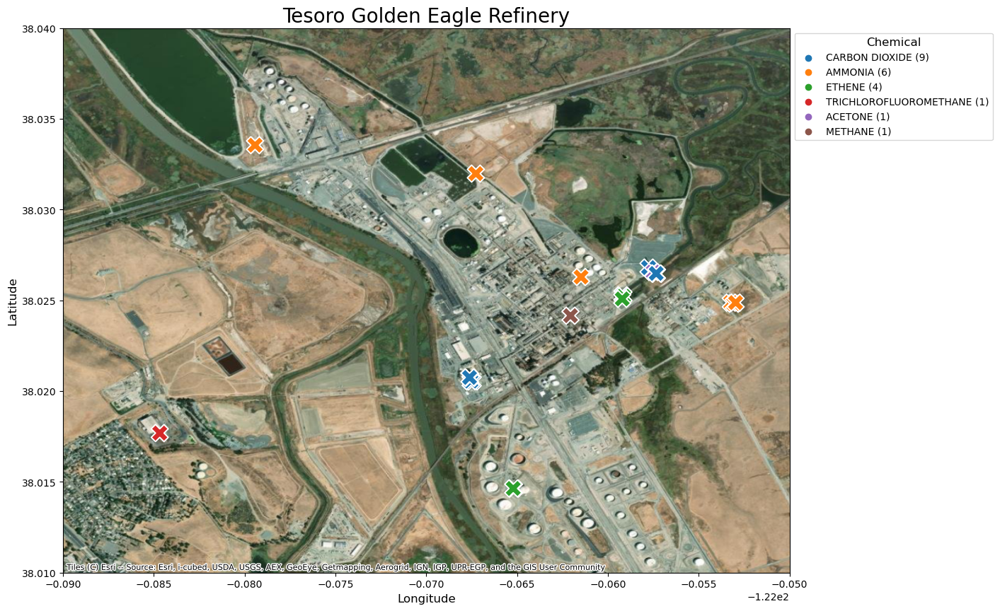

In [92]:
lat_min = 38.01
lat_max = 38.04
lon_min = -122.09
lon_max = -122.05
plumes = area_crop(df, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)
area_plot(title='Tesoro Golden Eagle Refinery', area_df=plumes, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)

---
# Valero Benicia Refinery & Valero Asphalt
3400 E 2nd St, Benicia, CA 94510 & 3001 Park Rd, Benicia, CA 94510

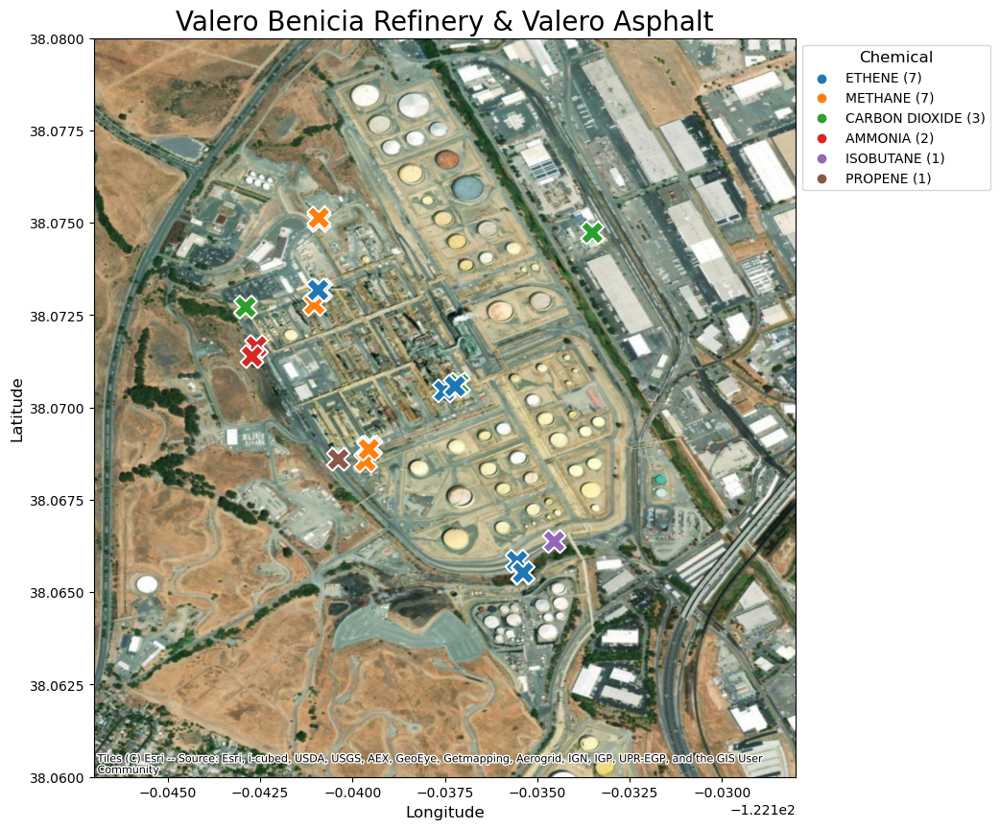

In [93]:
lat_min = 38.06
lat_max = 38.08
lon_min = -122.147
lon_max = -122.128
plumes = area_crop(df, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)
area_plot(title='Valero Benicia Refinery & Valero Asphalt', area_df=plumes, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)

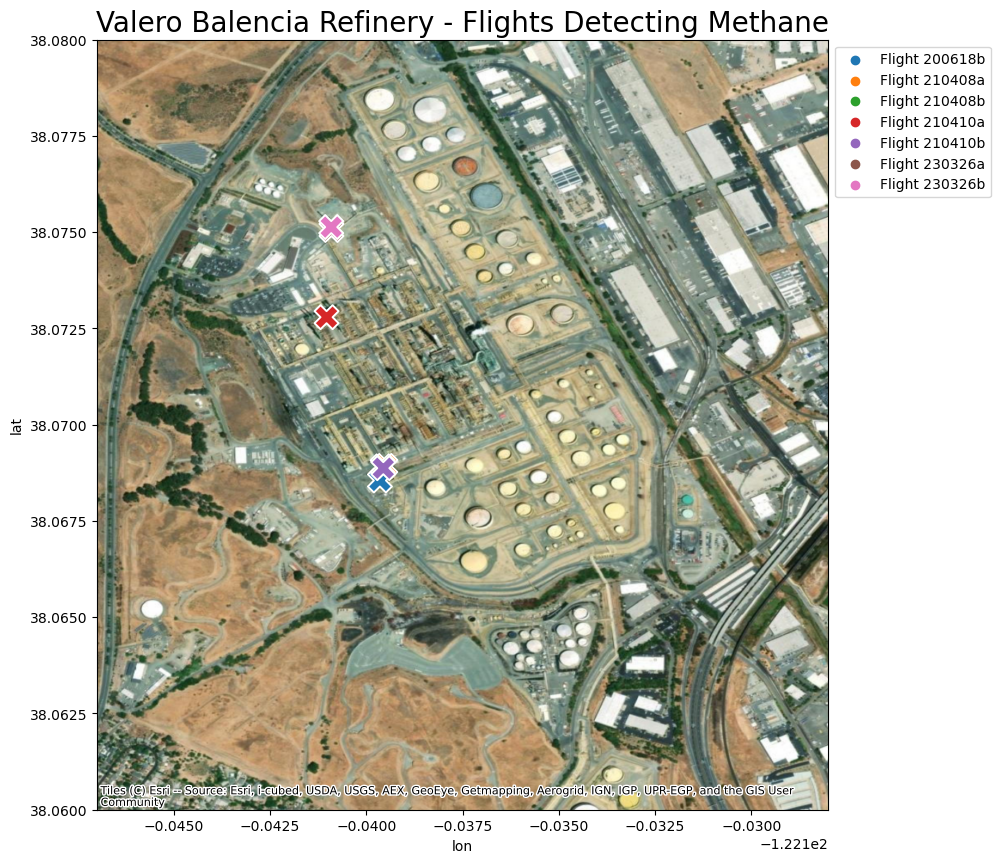

In [94]:
plt.figure(figsize=(14, 10))

df1 = df[
    (df['chemical'].isin(['METHANE'])) & 
    (df['lat'] >= 38.06) & 
    (df['lat'] <= 38.08) & 
    (df['lon'] >= -122.147) & 
    (df['lon'] <= -122.128)]

ax = sns.scatterplot(x=df1['lon'], y=df1['lat'], hue=df1['flight'], alpha=1, s=300, marker='X', legend=True)

plt.legend(title=None, loc='upper left', bbox_to_anchor=(1, 1))

ax.set_xlim(-122.147, -122.128)
ax.set_ylim(38.06, 38.08)
cx.add_basemap(ax, crs="EPSG:4326", source=cx.providers.Esri.WorldImagery)
ax.set_title('Valero Balencia Refinery - Flights Detecting Methane', fontsize=20)

plt.show()

---
# Oakland Airport Compressed Natural Gas (CNG) Station
7855 Earhart Rd, Oakland, CA 94621

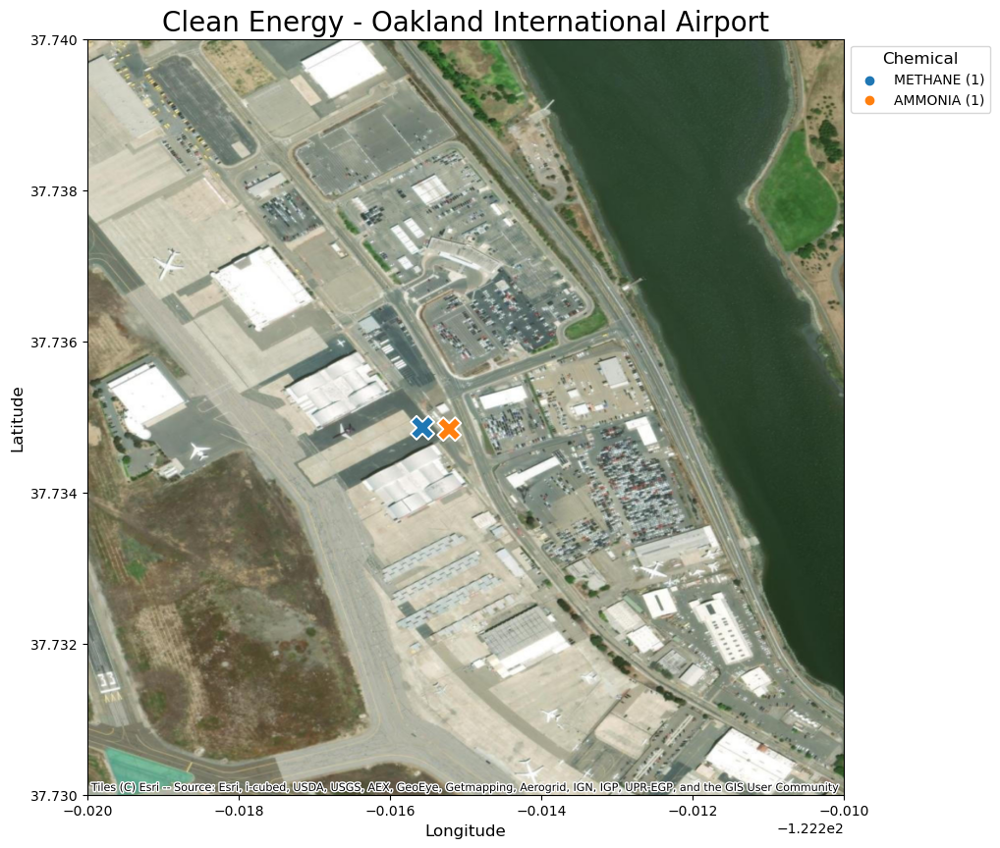

In [99]:
lat_min = 37.73
lat_max = 37.74
lon_min = -122.22
lon_max = -122.21
plumes = area_crop(df, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)
area_plot(title='Clean Energy - Oakland International Airport', area_df=plumes, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)

---
# San Francisco - Clearway Energy Steam Plant
460 Jessie St, San Francisco, CA 94103 (Permanently Closed)

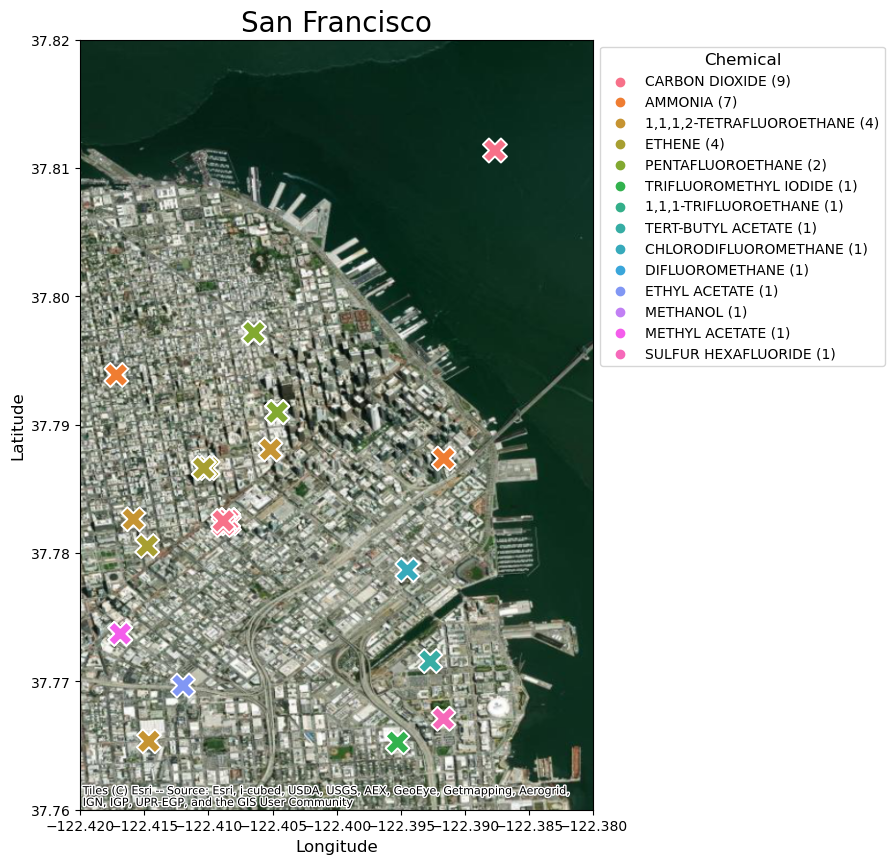

In [95]:
lat_min = 37.76
lat_max = 37.82
lon_min = -122.42
lon_max = -122.38
plumes = area_crop(df, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)
area_plot(title='San Francisco', area_df=plumes, min_lat=lat_min, max_lat=lat_max, min_lon=lon_min, max_lon=lon_max)

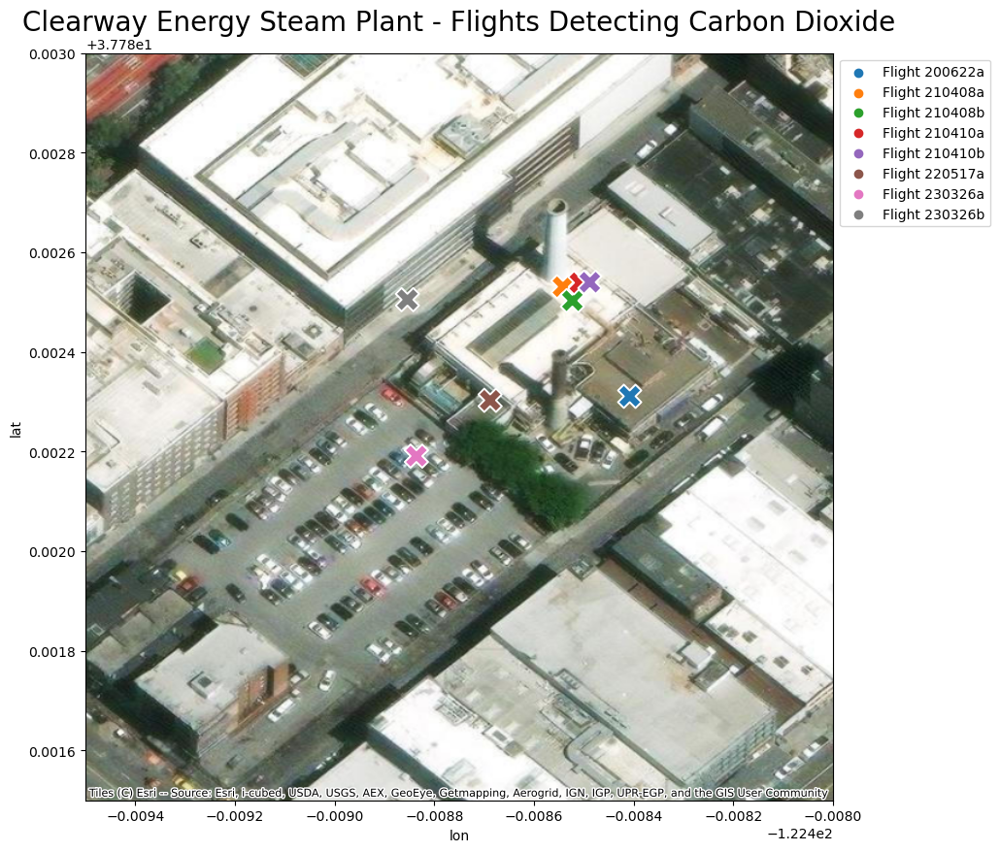

In [97]:
plt.figure(figsize=(14, 10))

df1 = df[
    (df['chemical'].isin(['CARBON DIOXIDE'])) & 
    (df['lat'] >= 37.7815) & 
    (df['lat'] <= 37.7830) & 
    (df['lon'] >= -122.4095) & 
    (df['lon'] <= -122.4080)]

ax = sns.scatterplot(x=df1['lon'], y=df1['lat'], hue=df1['flight'], alpha=1, s=300, marker='X', legend=True)

plt.legend(title=None, loc='upper left', bbox_to_anchor=(1, 1))

ax.set_xlim(-122.4095, -122.4080)
ax.set_ylim(37.7815, 37.7830)
cx.add_basemap(ax, crs="EPSG:4326", source=cx.providers.Esri.WorldImagery)
ax.set_title('Clearway Energy Steam Plant - Flights Detecting Carbon Dioxide', fontsize=20)

plt.show()

---
# Next Steps
Next steps for this part of the project may be
* Identifying and categorizing each of the detected plumes
* Identifying trends among the different categories of plumes (e.g., equestrian facilities, refineries)